# Yol Ağı Analizi ve Optimizasyonu

### **Elazığ Şehir Merkezi'ndeki Gazi Caddesi İçin Yol Optimizasyonu Çalışması**
Elazığ şehir merkezinde bulunan Gazi Caddesi, yüksek trafik yoğunluğu nedeniyle ulaşım açısından önemli bir sorun teşkil etmektedir. Bu çalışma, mevcut trafik verileri kullanılmaksızın, Gazi Caddesi üzerindeki taşıma yükünü azaltabilecek alternatif güzergâhların belirlenmesini amaçlamaktadır. Sürücülerin ana caddeyi kullanmaksızın ya da gerksiz yere işgal etmemesi amacıyla  tercih edebilecekleri mevcut yollar ve çevre güzergâhlar değerlendirilecektir. Açık alanlar, mevcut yol yapısı ve çevresel bağlantılar dikkate alınarak, trafik akışının daha verimli bir şekilde yönlendirilmesini sağlayacak öneriler geliştirilecektir. Bu sayede, Gazi Caddesi üzerindeki trafik yoğunluğu azaltılarak daha dengeli ve sürdürülebilir bir kentsel ulaşım sistemi oluşturulması hedeflenmektedir.

## Gerekli Kütüphanelerin Kurulumu

In [1]:
pip install numpy

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install osmnx

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install networkx

Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [6]:
pip install python-louvain

Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [8]:
pip install scipy


Note: you may need to restart the kernel to use updated packages.


In [9]:
pip install python-louvain


Note: you may need to restart the kernel to use updated packages.


## Projeye Kütüphanelerin Dahil Edilmesi

In [10]:
import osmnx as ox
import networkx as nx
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
from community import community_louvain
import folium
from folium.plugins import MarkerCluster
from folium.plugins import Fullscreen
from folium.plugins import MiniMap ,MousePosition
import plotly.graph_objects as go
from scipy.stats import entropy

## Şehir Yol Ağlarının Getirilmesi

In [11]:
# Elazığ (Gazi Caddesi) koordinatları
gazi_lat, gazi_lon = 38.6754194, 39.2153528

# Gazi Caddesi için yol ağı grafiği oluşturuluyor
G = ox.graph_from_point((gazi_lat, gazi_lon), dist=3000, dist_type = 'network' , network_type="drive" , retain_all = False , truncate_by_edge = False)
#osmnx.graph.graph_from_point(center_point, dist, *, dist_type='bbox' 'network', network_type={“all”, “all_public”, “bike”, “drive”, “drive_service”, “walk”} , simplify=True, retain_all=False, truncate_by_edge=False, custom_filter=None)

# Düğümleri al
gazi_nodes = list(G.nodes())

# Kenarları al
gazi_edges = list(G.edges())

print("Gazi Caddesi için yol ağı oluşturuldu.")
print(f"Toplam düğüm sayısı: {len(gazi_nodes)}")
print(f"Toplam kenar sayısı: {len(gazi_edges)}")
print(f"Graf türü: {type(G)}")


#print("\n Gazi Caddesi Düğüm Listeleri:")
#print ("gazi_nodes")

#print("\n Gazi Caddesi Kenar Listeleri:")
#print ("gazi_edges")


Gazi Caddesi için yol ağı oluşturuldu.
Toplam düğüm sayısı: 2597
Toplam kenar sayısı: 7102
Graf türü: <class 'networkx.classes.multidigraph.MultiDiGraph'>


- **2597 Düğüm:** Bunlar, yol ağı içindeki kesişim noktaları, yol noktaları veya bağlantı noktalarıdır.
- **7102 Kenar:**  Bunlar, düğümler arasındaki yol bağlantılarıdır. Her bir kenar, bir yol segmentini temsil eder.
- **MultiDiGraph:** Çok yönlü, yönlendirilmiş bir grafik yapısı. Aynı iki düğüm arasında birden fazla yol bulunabilir, yani yollar çift yönlü olabilir.


## Şehir Yol Ağı Grafik Görselleştirmesi

In [12]:
# Harita oluşturuluyor
m = folium.Map(location=[gazi_lat, gazi_lon], zoom_start=13)

# TileLayer
folium.TileLayer(
    tiles='https://tiles.stadiamaps.com/tiles/alidade_satellite/{z}/{x}/{y}{r}.{ext}',
    attr='Stadia Maps',
    name='Uydu',
    ext='png'
).add_to(m)

# Düğümleri MarkerCluster ile gruplama
marker_cluster = MarkerCluster().add_to(m)

# Düğümleri haritaya ekleme
for node, data in G.nodes(data=True):
    folium.Marker(
        location=[data['y'], data['x']],
        popup=f"Düğüm: {node}",
        icon=folium.Icon(color="blue", icon="flag")
    ).add_to(marker_cluster)

# Yol geometrilerini çıkarma (kenarlar) nx -> geodataframe
edges_gdf = ox.graph_to_gdfs(G, nodes=False, edges=True)

# Yolları haritaya ekleme
for _, row in edges_gdf.iterrows():
  
    line = row['geometry']
    
    road_length = row['length']
    
    road_type = row.get('highway', 'Bilinmiyor')
    
    if isinstance(road_type, list):
        road_type = ', '.join(road_type)
    
    lat_lon_u = (line.coords[0][1], line.coords[0][0])  # Başlangıç noktası
    lat_lon_v = (line.coords[-1][1], line.coords[-1][0])  # Bitiş noktası
    
    popup_content = f"""
    <strong>Yol Bilgisi</strong><br>
    <b>Bağlantı Noktaları:</b><br>
    Nokta ({lat_lon_u}) - Nokta ({lat_lon_v})<br><br>
    <b>Yol Uzunluğu:</b> {road_length:.2f} m<br>
    <b>Yol Türü:</b> {road_type.capitalize()}<br>
    """
    
    # Yol geometrisini haritaya ekleme
    folium.PolyLine(
        locations=[(lat, lon) for lon, lat in line.coords],
        color="red", 
        weight=4,     
        opacity=0.7
    ).add_to(m).add_child(folium.Popup(popup_content, max_width=300))

# Tam ekran butonu ekleme
folium.plugins.Fullscreen(
    position="topright",
    title="Beni genişlet",
    title_cancel="Çıkmak için tıklayın",
    force_separate_button=True,
).add_to(m)

# Mini harita ekleme
folium.plugins.MiniMap(toggle_display=True).add_to(m)

# Fare konumunu gösterme
formatter = "function(num) { return num.toFixed(6); }" 
folium.plugins.MousePosition(
    position="topright",
    separator=" | ",
    empty_string="NaN",
    lng_first=True,
    num_digits=6,  # 6 haneli hassasiyet
    prefix="Koordinatlar: ",
    lat_formatter=formatter,
    lng_formatter=formatter
).add_to(m)

# Sağ ve sol katmanları oluşturma
layer_right = folium.TileLayer('Stamen Terrain')
layer_left = folium.TileLayer('OpenStreetMap')
sbs = folium.plugins.SideBySideLayers(layer_left=layer_left, layer_right=layer_right)
layer_left.add_to(m)
layer_right.add_to(m)
sbs.add_to(m)

# Harita sonlandırma
m


## Derece Merkeziliği (Degree Centrality) 


Derece Merkeziliği, bir düğümün ağdaki diğer düğümlerle olan bağlantı sayısını ölçen basit ve yaygın olarak kullanılan bir ağ merkeziliği ölçüsüdür. Bu ölçü, bir düğümün ağdaki ne kadar merkezi olduğunu ve diğer düğümlerle kaç bağlantısı olduğunu belirlemeye yardımcı olur.

#### Derece Merkeziliği Nasıl Hesaplanır?

- **Yönsüz Ağlarda**: Bir düğümün derece merkeziliği, o düğüme bağlı olan kenar sayısı ile belirlenir.


  $$
  C_D(v) = \frac{\text{Bağlantı sayısı (derece)}}{\text{Toplam düğüm sayısı} - 1}
  $$

   Nerede:
  - $C_D(v)$, $v$ düğümünün derece merkeziliğidir,
  - Bağlantı sayısı, düğüme bağlı olan kenar sayısıdır,
  - Toplam düğüm sayısı, ağdaki toplam düğüm sayısını ifade eder.


- **Yönlendirilmiş Ağlarda**: Derece merkeziliği, gelen bağlantılar (in-degree) ve giden bağlantılar (out-degree) için ayrı ayrı hesaplanabilir.

  - Gelen bağlantılar için:

  $$
  C_D(v)_{\text{in}} = \frac{\text{Gelen kenar sayısı}}{\text{Toplam düğüm sayısı} - 1}
  $$

  - Giden bağlantılar için:

  $$
  C_D(v)_{\text{out}} = \frac{\text{Giden kenar sayısı}}{\text{Toplam düğüm sayısı} - 1}
  $$

#### Derece Merkeziliğinin Anlamı

- **Yüksek Derece Merkeziliği**: Ağda daha fazla bağlantısı olan bir düğüm, daha merkezi olarak kabul edilir. Bu, ağda daha fazla etki veya kontrol sahibi olduğu anlamına gelir.

- **Düşük Derece Merkeziliği**: Ağda daha az bağlantısı olan bir düğüm daha izole olmuş durumdadır ve ağdaki etkisi sınırlıdır.



In [13]:
# Derece merkeziliğini hesapla
degree_centrality = nx.degree_centrality(G)

#print("Her bir düğüm için derece merkeziliği:")
#for node, centrality in degree_centrality.items():
    #print(f"Düğüm {node}: {centrality}")


In [14]:
# Düğümleri derece merkeziliğine göre azalan sırayla sırala
sorted_degree_centrality = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)

#print("Her bir düğüm için derece merkeziliği (sıralı):")
#for node, centrality in sorted_degree_centrality:
    #print(f"Düğüm {node}: {centrality}")


In [15]:
# Ağda her bir bağlantı sayısı için düğüm sayısını hesaplar.
degree = nx.degree_histogram(G) 

# Ağdaki her derecenin yüzdesini hesaplar
perc_degree = [((d * 100) / G.number_of_nodes()) for d in degree] 

# Bu, derece değerlerinin aralığını oluşturur
deg_domain = list(range(0, len(degree)))  

# Plotly figürünü oluşturur
fig = go.Figure()

# Veriyi figüre ekler
fig.add_trace(go.Scatter(
    x=deg_domain, 
    y=perc_degree,
    mode='lines+markers',
    name=f'Derece Dağılımı Gazi Caddesi',
    line=dict(width=2),  
    marker=dict(size=6)  
))

# Layout ayarlarını yapar
fig.update_layout(
    title=f"Derece Dağılımı Gazi Caddesi",
    xaxis_title="Derece",
    yaxis_title="Düğümlerin Yüzdesi (%)",
    showlegend=True,
    template="plotly_dark", 
    hovermode='closest'
)

fig.show()

degree_data = {
    "Derece" : deg_domain , 
    "Düğümlerin Yüzdesi" : perc_degree
}

df = pd.DataFrame(degree_data)
print(df)


    Derece  Düğümlerin Yüzdesi
0        0            0.000000
1        1            0.269542
2        2            5.891413
3        3            5.429342
4        4           16.634578
5        5            1.540239
6        6           58.914132
7        7            0.077012
8        8           11.051213
9        9            0.000000
10      10            0.192530


### Derece Merkeziliği Entropisi

Genel olarak, entropi bir sistemdeki belirsizlik veya düzensizliği ölçer. Ağ analizi bağlamında, entropi, bir ağdaki bağlantıların dağılımındaki çeşitliliği ve düzensizliği anlamamıza yardımcı olur. Yüksek entropi genellikle, ağdaki düğümlerin merkeziliğinin düzensiz bir şekilde dağıldığını gösterir. Bu durumda, bazı düğümler daha merkezi olabilirken, diğerleri daha izole olabilir. Diğer taraftan, düşük entropi, ağdaki derece dağılımının daha homojen olduğunu gösterir. Böyle bir ağda, tüm düğümler benzer derecelere sahip olabilir ve belirgin bir merkezileşme yoktur. Bu tür bir ağda, düğümlerin bağlantı sayıları birbirine yakın olup, ağ daha düzenli bir yapıya sahip olur.

#### Entropi Hesaplama Formülü:

Entropi aşağıdaki formül kullanılarak hesaplanır:

$$
H(X) = - \sum_{i=1}^{n} p_i \log(p_i)
$$

- $H(X)$: Entropi değeri
- $p_i$: Her bir derecenin olasılıkları (yani ağdaki belirli bir dereceye sahip düğümlerin oranı)
- $n$: Düğüm sayısı veya derece türleri

Bu formüle göre, ne kadar fazla çeşitlilik ve düzensizlik varsa, entropi değeri o kadar yüksek olacaktır.


In [16]:
total_nodes = G.number_of_nodes()

degree_probabilities = [count / total_nodes for count in degree]


entropy = -np.sum(np.array(degree_probabilities) * np.log2(np.array(degree_probabilities) + 1e-9))

print(f"Derece Dağılımı Entropisi: {entropy}")


Derece Dağılımı Entropisi: 1.8412870424394356


Ağım için hesapladığım entropi değeri 1.8412870424394356'dir, bu da ağımın derece dağılımının yüksek bir çeşitliliğe sahip olduğunu ve ağda belirgin bir düzensizlik ve eşitsizlik bulunduğunu gösterir. Yüksek entropi, ağdaki düğümler arasındaki bağlantı sayısının önemli ölçüde değiştiği anlamına gelir, yani ağım düzensizdir. Bu, bazı düğümlerin çok sayıda bağlantıya sahip olduğunu, bazılarının ise çok az bağlantıya sahip olduğunu gösterir. Bu tür bir yapı, ağımda merkezi düğümlerin varlığını gösterir, ancak aynı zamanda birçok düğümün izole olduğunu da gösterir. Bağlantı çeşitliliği yüksek olduğundan, ağımda merkezileşme düzgün bir şekilde dağılmamış ve daha dengesizdir. Bu, ağımın düğümler arasında önemli bir eşitsizlik içeren karmaşık bir yapıya sahip olduğunu gösterir.

# Yakınlık Merkeziliği(Closeness Centrality)

### Yakınlık Merkeziliği

Yakınlık Merkeziliği, bir düğümün ağdaki diğer tüm düğümlere olan ortalama en kısa mesafenin tersini temsil eden bir merkezilik ölçüsüdür. Bu metrik, bir düğümün ağdaki diğer düğümlere ne kadar hızlı ve doğrudan erişebileceğini gösterir. Diğer bir deyişle, bir düğümün diğer düğümlere olan yolları ne kadar kısaysa, yakınlık merkeziliği değeri o kadar yüksek olur. Bu, düğümün bilgi akışı veya erişilebilirlik açısından daha merkezi bir konumda olduğunu gösterir.

Yakınlık Merkeziliği aşağıdaki formül ile hesaplanır:

$$
C_C(v) = \frac{n - 1}{\sum_{u \neq v} d(v, u)}
$$

Burada:

- $C_C(v)$, $v$ düğümünün yakınlık merkeziliği değeridir,
- $d(v, u)$, $v$ düğümünden $u$ düğümüne olan en kısa yol mesafesidir,
- $n$, ağdaki toplam düğüm sayısını ifade eder.

Bu formül, bir düğümden diğer tüm düğümlere olan toplam mesafeyi hesaplar ve bu toplamın tersini alır. Bu nedenle, diğer düğümlere daha kısa toplam mesafeye sahip düğümler daha yüksek yakınlık merkeziliği değerlerine sahip olur.


In [17]:
# Yakınlık merkeziliğini hesapla
closeness_centrality = nx.closeness_centrality(G)

#print("Her bir düğüm için yakınlık merkeziliği:")
#for node, value in closeness_centrality.items():
    #print(f"Düğüm {node}: {value:.4f}")


In [18]:
sorted_closeness = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)

#print("\nYakınlık Merkeziliğine Göre Düğümler (Azalan Sırayla):")
#for node, value in sorted_closeness:
    #print(f"Düğüm {node}: {value:.4f}")


In [19]:
closeness_values = list(closeness_centrality.values())

closeness_stats = {
    'Min': np.min(closeness_values),
    '1st Quartile': np.percentile(closeness_values, 25),
    'Median': np.median(closeness_values),
    '3rd Quartile': np.percentile(closeness_values, 75),
    'Max': np.max(closeness_values),
    'Mean': np.mean(closeness_values),
}

print("Yakınlık Merkeziliği İstatistikleri:")
for stat, value in closeness_stats.items():
    print(f"{stat}: {value:.4f}")


Yakınlık Merkeziliği İstatistikleri:
Min: 0.0218
1st Quartile: 0.0307
Median: 0.0340
3rd Quartile: 0.0373
Max: 0.0447
Mean: 0.0339


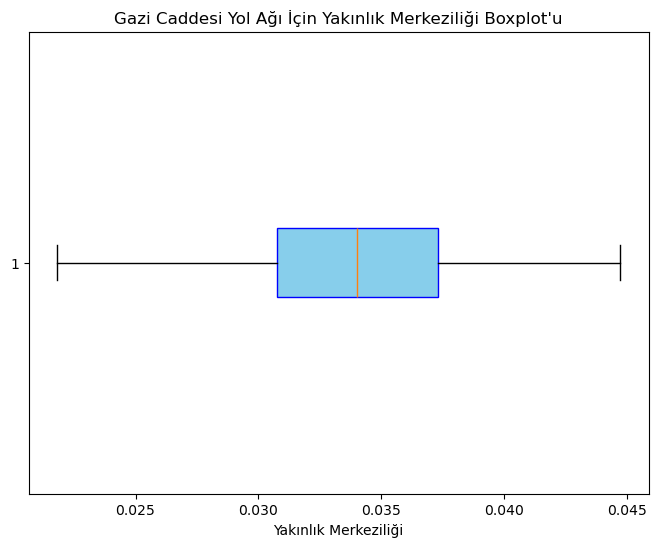

In [20]:
plt.figure(figsize=(8,6))
plt.boxplot(closeness_values, vert=False, patch_artist=True, boxprops=dict(facecolor="skyblue", color="blue"), 
            flierprops=dict(markerfacecolor='red', marker='o', markersize=6, linestyle='none'))
plt.title("Gazi Caddesi Yol Ağı İçin Yakınlık Merkeziliği Boxplot'u")
plt.xlabel("Yakınlık Merkeziliği")
plt.show()


Ağımda en düşük Yakınlık Merkeziliği değeri olan 0.0218, bazı düğümlerin diğer düğümlere ulaşmak için daha uzun yollar kat ettiğini gösteriyor. Bu düğümler, ağda daha izole olmuş ya da daha uzak noktalarda yer alıyor olabilir.

Öte yandan, ağımda merkezi pozisyonlarda bulunan düğümlerin sayısı da önemli. İlk çeyrek değeri olan 0.0307 ile üçüncü çeyrek değeri olan 0.0373 arasındaki fark, ağımda bazı düğümlerin diğerlerinden daha merkezi olduğunu gösteriyor. Bu da ağımda daha merkezi düğümlerin bulunduğuna işaret ediyor.

Medyan değeri olan 0.0340, ağımda çoğu düğümün ortalama bir merkeziliğe sahip olduğunu ortaya koyuyor. Ortalama değer olan 0.0339 ise düğümler arasında büyük bir farklılık olmadığını ve genel olarak merkeziliğin oldukça dengeli bir şekilde dağıldığını gösteriyor.

En yüksek Yakınlık Merkeziliği değeri olan 0.0447, ağımda tüm diğer düğümlere en hızlı şekilde ulaşabilen, oldukça merkezi bir düğümün olduğunu gösteriyor.


# Topluluk (Community)

Modülerlik, bir ağın yapısal bütünlüğünü belirlemek ve düğümlerin nasıl kümelenebileceğini incelemek için kullanılır. Bir ağda, topluluklar, topluluk içindeki düğümler arasında birçok bağlantıya sahipken, topluluklar arasındaki bağlantılar daha azdır. Modülerlik, bu tür yapıları tanımlamaya yardımcı olur.

### Modülerlik Nasıl Hesaplanır?
Modülerlik, bir ağdaki toplulukların birbirlerine ne kadar güçlü bir şekilde bağlandığını ölçer. Modülerlik değeri şu şekilde hesaplanır:

$$
Q = \frac{1}{2m} \sum_{i,j} \left( A_{ij} - \frac{k_i k_j}{2m} \right) \delta(c_i, c_j)
$$

Burada:

- $Q$ modülerlik değerini temsil eder.
- $A_{ij}$ iki düğüm arasındaki gerçek bağlantıyı gösterir. Yani, $A_{ij} = 1$ eğer düğüm $i$ ve düğüm $j$ arasında bir bağlantı varsa, $A_{ij} = 0$ ise bağlantı yoksa.
- $k_i$ ve $k_j$ sırasıyla düğüm $i$ ve düğüm $j$'nin derecelerini (bağlantı sayıları) temsil eder.
- $m$ ağdaki toplam kenar (bağlantı) sayısını temsil eder.
- $\delta(c_i, c_j)$, düğüm $i$ ve $j$'nin aynı topluluğa ait olup olmadığını belirten bir fonksiyondur. Eğer aynı topluluğa aitlerse, $\delta(c_i, c_j) = 1$ olur, aksi takdirde 0'dır.

### Yüksek ve Düşük Modülerlik:
- **Yüksek Modülerlik**: Yüksek modülerlik, ağda belirgin topluluk yapılarını gösterir ve çoğu düğüm, kendi toplulukları içinde güçlü bağlantılara sahiptir. Bu, ağın farklı topluluklara sahip olduğunu ve topluluklar arası bağlantıların daha az olduğunu ifade eder.
- **Düşük Modülerlik**: Düşük modülerlik, ağın daha homojen olduğunu ve daha az belirgin topluluklara sahip olduğunu gösterir. Bu, ağda net ayrımların olmadığını ve düğümlerin ağ genelinde daha eşit şekilde bağlantılı olduğunu ima eder.


In [21]:
# Yönlendirilmiş grafiği yönlendirilmemiş grafiğe çevirme
G_undirected = G.to_undirected()

# Louvain yöntemi ile toplulukları tespit etme
partition = community_louvain.best_partition(G_undirected)

# Modülerlik değerini hesaplama
modularity = community_louvain.modularity(partition, G_undirected)

# Sonuçları yazdırma
print(f"Gazi Caddesi için modülerlik: {modularity}")


Gazi Caddesi için modülerlik: 0.908698516076203


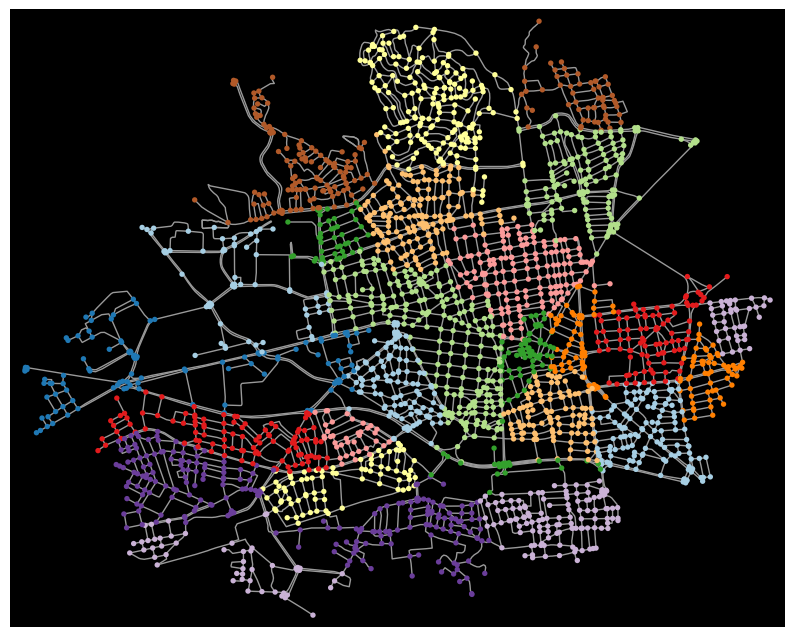

In [22]:
# Topluluklar için renk atama
nx.set_node_attributes(G_undirected, partition, name="attr_city")
nc = ox.plot.get_node_colors_by_attr(G_undirected, attr="attr_city", cmap='Paired')

# Grafiği çizme
fig, ax = ox.plot_graph(G_undirected, figsize=(10, 10), bgcolor="k", node_color=nc)
plt.pause(0.05)
plt.show()


Gazi Caddesi için hesaplanan modülerlik değeri 0.9089533711857269 olup, ağ içinde güçlü bir topluluk yapısına işaret etmektedir. Modülerlik değeri 1'e yakın olduğunda, ağın topluluklara iyi bir şekilde ayrıldığını, her topluluk içinde yoğun bağlantılar ve topluluklar arasında seyrek bağlantılar olduğunu gösterir. Bu sonuç, Gazi Caddesi'nin iyi tanımlanmış ve birbirinden ayrı topluluklara sahip olduğunu, ağın yapısının rastgele olmadığını vurgulamaktadır.

# Aracılık Merkeziliği (Betweenness Centrality)

Ağdaki düğümlerin, diğer düğümler arasındaki en kısa yol üzerinde ne sıklıkla yer aldığını ölçen bir merkeziyet ölçüsüdür. Yüksek aracılık merkeziliği değeri, bir düğümün önemli bir aracı olduğunu ve diğer düğümler arasındaki bilgi akışını kontrol ettiğini gösterir. Bu düğümler ağda köprü noktaları olarak kabul edilir ve iletişim ve bilgi yayılımı açısından kritik bir rol oynar. Aracılık merkeziliği şu formül ile hesaplanır:

$$
C_B(v) = \sum_{s,t \in V, s \neq t \neq v} \frac{\sigma_{st}(v)}{\sigma_{st}}
$$

Burada:
- $C_B(v)$, düğüm $v$'nin aracılık merkeziliğini temsil eder,
- $\sigma_{st}$, düğüm $s$ ve $t$ arasındaki en kısa yol sayısını temsil eder,
- $\sigma_{st}(v)$, düğüm $s$ ile $t$ arasındaki ve düğüm $v$'yi içeren en kısa yolların sayısını temsil eder.

Bu metrik, ağdaki kritik düğümleri belirlemek için faydalıdır ve ağın yapısal özelliklerini anlamada önemli bir rol oynar.


In [23]:
# Aracılık Merkeziliği Hesaplama
betweenness_centrality = nx.betweenness_centrality(G)

# Aracılık Merkeziliği değerlerini al
betweenness_values = list(betweenness_centrality.values())

# İstatistiksel özet
betweenness_stats = {
    'Min': np.min(betweenness_values),
    '1. Çeyrek': np.percentile(betweenness_values, 25),
    'Medyan': np.median(betweenness_values),
    '3. Çeyrek': np.percentile(betweenness_values, 75),
    'Max': np.max(betweenness_values),
    'Ortalama': np.mean(betweenness_values),
}

# Özet istatistiklerini yazdırma
print("Aracılık Merkeziliği İstatistikleri:")
for stat, value in betweenness_stats.items():
    print(f"{stat}: {value:.4f}")


Aracılık Merkeziliği İstatistikleri:
Min: 0.0000
1. Çeyrek: 0.0012
Medyan: 0.0036
3. Çeyrek: 0.0114
Max: 0.1413
Ortalama: 0.0109


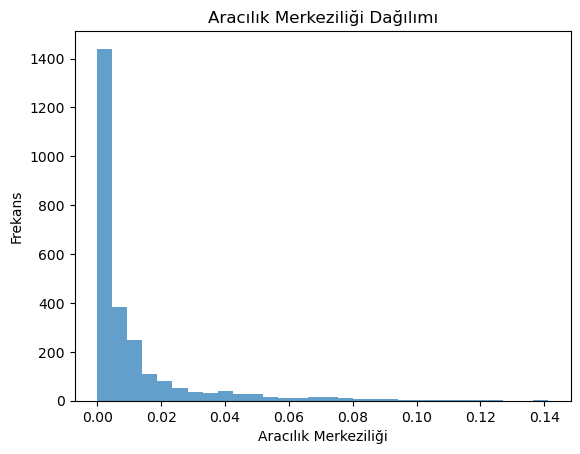

In [24]:
# Aracılık Merkeziliği değerlerinin dağılımını çizme
plt.hist(betweenness_values, bins=30, alpha=0.7)
plt.title('Aracılık Merkeziliği Dağılımı')
plt.xlabel('Aracılık Merkeziliği')
plt.ylabel('Frekans')
plt.show()


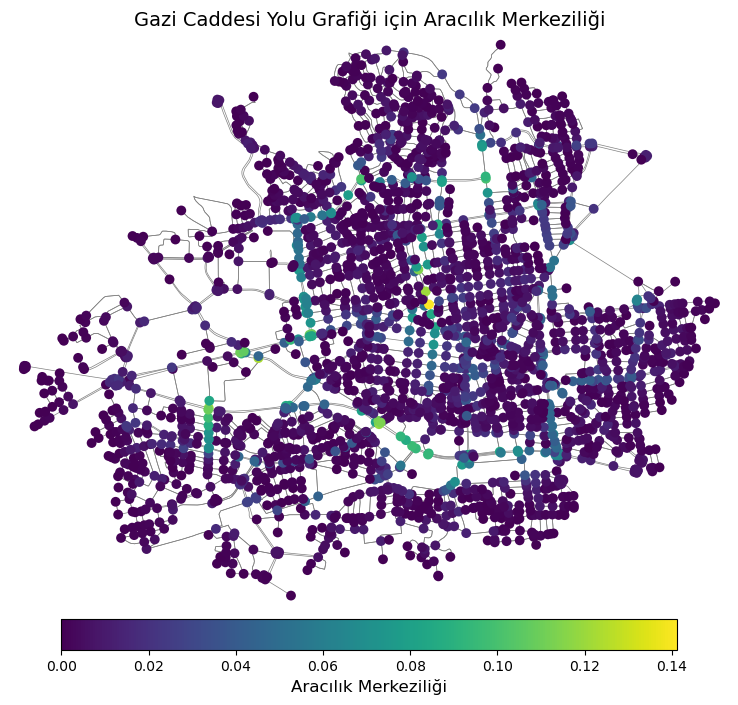

In [25]:
# Aracılık Merkeziliği değerlerine göre düğüm renklerini belirleme
node_colors = [betweenness_centrality[node] for node in G.nodes()]

# Grafik boyutunu ayarlama
fig, ax = plt.subplots(figsize=(10, 8))  # Manual olarak ax oluşturduk

# Değerleri normalize etme ve bir renk paleti seçme (cmap)
norm = mpl.colors.Normalize(vmin=min(betweenness_values), vmax=max(betweenness_values))
cmap = mpl.cm.viridis  # Yeşil tonları içeren bir renk paleti seçildi

# Ağ grafiğini çizme
ox.plot_graph(G, node_color=node_colors, node_size=50, edge_color="gray", edge_linewidth=0.5, ax=ax, show=False)

# Renk çubuğu ekleme
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, orientation="horizontal", fraction=0.05, pad=0.02)
cbar.set_label("Aracılık Merkeziliği", fontsize=12)

# Başlık ekleme
plt.title("Gazi Caddesi Yolu Grafiği için Aracılık Merkeziliği", fontsize=14)

# Grafiği gösterme
plt.show()


**Aracılık Merkeziliği İstatistiklerine Göre:**

- **Minimum (0.0000):** Bazı düğümler ağda hiçbir iletişim aracılığı yapmamaktadır, yani bu düğümler ağdaki bilgi akışında önemli bir rol oynamazlar.

- **1. Çeyrek (0.0012) ve Medyan (0.0036):** Çoğu düğümün düşük aracılık merkeziliği değeri vardır, yani bu düğümler ağdaki bilgi akışını yönlendirmede herhangi bir rol oynamazlar.

- **3. Çeyrek (0.0114):** Bazı düğümler daha yüksek aracılık merkeziliği değerlerine sahip olup, ağın farklı kısımları arasında önemli köprüler işlevi görürler.

- **Maksimum (0.1413):** En yüksek değer, ağda çok merkezi bir düğüm olduğunu ve bu düğümün birçok diğer düğüm arasında iletişimi aracılık ettiğini gösterir.

- **Ortalama (0.0109):** Genel olarak, ağdaki çoğu düğüm düşük aracılık merkeziliği değerine sahiptir, yani sadece birkaç düğüm önemli bağlantılar sağlarken, çoğu düğüm bu rolü oynamaz.


##  PageRank Merkeziliği (PageRank Centrality)

PageRank, her düğüme aldığı bağlantıların sayısı ve kalitesine (veya gelen bağlantılara) dayalı bir puan atar. Temel fikir, birçok önemli düğümden bağlantı alan bir düğümün de önemli olduğudur.

Bir düğüm \( v \) için PageRank şu şekilde hesaplanabilir:

$$
PR(v) = \frac{1 - d}{N} + d \sum_{u \in \text{In}(v)} \frac{PR(u)}{L(u)}
$$

Burada:
- \( PR(v) \), düğüm \( v \)'nin PageRank değerini temsil eder,
- \( d \), damping faktörüdür (genellikle 0.85 olarak ayarlanır),
- \( N \), ağdaki toplam düğüm sayısını belirtir,
- \( \text{In}(v) \), \( v \)'ye bağlantı yapan düğümlerin kümesidir,
- \( L(u) \), \( u \) düğümünden çıkan bağlantı sayısını (yani \( u \) düğümünün derecesini) ifade eder.

Bu formül, her düğümün öneminin, ona bağlantı yapan düğümlerin öneminden etkilendiği PageRank'in yinelemeli hesaplanmasını temsil eder.


In [26]:
# PageRank merkeziliğini hesapla
pagerank_centrality = nx.pagerank(G, alpha=0.85)

print(len(G))

# PageRank değerlerini görüntüle
#for node, pr in pagerank_centrality.items():
    #print(f"Düğüm {node}: PageRank = {pr:.4f}")


2597


In [27]:
# En yüksek PageRank değerine sahip ilk 5 düğümü al
top_5_pagerank = sorted(pagerank_centrality.items(), key=lambda x: x[1], reverse=True)[:5]

print("\nEn Yüksek PageRank Değerine Sahip İlk 5 Düğüm:")
for node, pr in top_5_pagerank:
    print(f"Düğüm {node}: PageRank = {pr:.4f}")



En Yüksek PageRank Değerine Sahip İlk 5 Düğüm:
Düğüm 2204307492: PageRank = 0.0008
Düğüm 2204487567: PageRank = 0.0007
Düğüm 2204400289: PageRank = 0.0007
Düğüm 2203337530: PageRank = 0.0007
Düğüm 2204369194: PageRank = 0.0007


In [28]:
node_id = 2204307492

pagerank_value = pagerank_centrality[node_id]

neighbors = list(G.neighbors(node_id))

degree = G.degree(node_id)

print(f"Düğüm {node_id} Bilgileri:")
print(f"PageRank Değeri: {pagerank_value:.4f}")
print(f"Komşular: {neighbors}")
print(f"Derece: {degree}")


Düğüm 2204307492 Bilgileri:
PageRank Değeri: 0.0008
Komşular: [2204307491, 6583702245, 2204307488]
Derece: 5


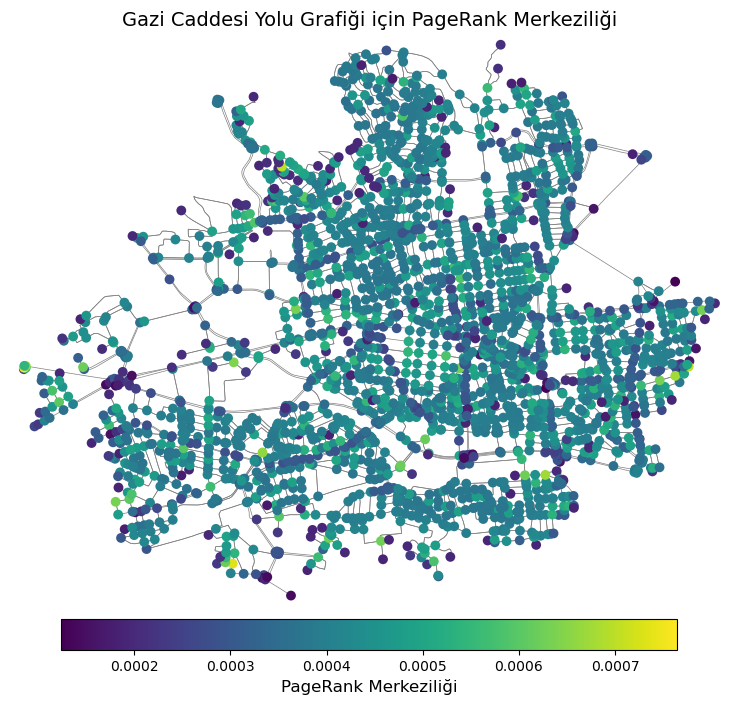

In [29]:
# PageRank merkeziliği değerlerine göre düğüm renklerini belirleme
node_colors = [pagerank_centrality[node] for node in G.nodes()]

fig, ax = plt.subplots(figsize=(10, 8))  

# Değerleri normalize etme ve bir renk paleti seçme (cmap)
norm = mpl.colors.Normalize(vmin=min(pagerank_centrality.values()), vmax=max(pagerank_centrality.values()))
cmap = mpl.cm.viridis  

# Ağ grafiğini çizme
ox.plot_graph(G, node_color=node_colors, node_size=50, edge_color="gray", edge_linewidth=0.5, ax=ax, show=False)

# Renk çubuğu ekleme
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, orientation="horizontal", fraction=0.05, pad=0.02)
cbar.set_label("PageRank Merkeziliği", fontsize=12)

# Başlık ekleme
plt.title("Gazi Caddesi Yolu Grafiği için PageRank Merkeziliği", fontsize=14)

# Grafiği gösterme
plt.show()


PageRank Merkeziliği, grafiğin kenar düğümlerinde yoğunlaşmış gibi görünüyor, bu da genellikle beklenenden farklıdır. Normalde, en kritik bağlantı noktalarının merkezde olması beklenir, ancak burada bazı periferik düğümler aşırı yüksek değerlere sahip. Bu durum, eksik bağlantılar, yönlendirme hataları veya PageRank hesaplamasında ağırlıkların düzensiz dağılımı olabileceğini düşündürmektedir. Analizin doğruluğunu artırmak için, diğer merkezilik ölçütleriyle karşılaştırmak ve ağ yapısını doğrulamak faydalı olacaktır.

---

In [47]:
import folium
import osmnx as ox
import networkx as nx
from folium.plugins import MarkerCluster
from IPython.display import display

# Başlangıç ve bitiş koordinatlarını belirleyin (örnek olarak Gazi Caddesi'nin iki noktası)
start_lat, start_lon = 38.6809, 39.2237  # Gazi Caddesi Başlangıç
end_lat, end_lon = 38.6815, 39.2282  # Gazi Caddesi Bitişi

# Bölge için bir ağ grafiği oluşturun
place_name = "Elazig, Turkey"
G = ox.graph_from_place(place_name, network_type='all')

# Grafiği basitleştiriyoruz (çoklu kenarları tekli kenara çeviriyoruz)
G = nx.Graph(G)  # Bu adım, çoklu kenarları tekli kenara indirger

# Temel harita oluşturuluyor
m = folium.Map(location=[start_lat, start_lon], zoom_start=13)

# TileLayer (Uydu haritası)
folium.TileLayer(
    tiles='https://tiles.stadiamaps.com/tiles/alidade_satellite/{z}/{x}/{y}{r}.{ext}',
    attr='Stadia Maps',
    name='Uydu',
    ext='png'
).add_to(m)

# Başlangıç ve bitiş noktalarına en yakın node'ları buluyoruz
start_node = ox.distance.nearest_nodes(G, X=start_lon, Y=start_lat)
end_node = ox.distance.nearest_nodes(G, X=end_lon, Y=end_lat)

from itertools import islice

# En kısa yolu hesaplıyoruz (1. yol)
shortest_path = nx.shortest_path(G, source=start_node, target=end_node, weight='length')

# İlk iki kısa yolu (alternatif güzergahlar) al
k_paths = list(islice(nx.shortest_simple_paths(G, source=start_node, target=end_node, weight='length'), 2))

# Koordinatlara dönüştür
path_coords_1 = [(G.nodes[node]['y'], G.nodes[node]['x']) for node in k_paths[0]]
path_coords_2 = [(G.nodes[node]['y'], G.nodes[node]['x']) for node in k_paths[1]]


# İlk yolu haritaya ekliyoruz
folium.PolyLine(locations=path_coords_1, color='red', weight=4, opacity=0.7).add_to(m)

# İkinci yolu haritaya ekliyoruz
folium.PolyLine(locations=path_coords_2, color='blue', weight=4, opacity=0.7).add_to(m)

# Başlangıç ve bitiş noktalarını haritada gösterelim
folium.Marker([start_lat, start_lon], popup="Başlangıç", icon=folium.Icon(color="green")).add_to(m)
folium.Marker([end_lat, end_lon], popup="Bitiş", icon=folium.Icon(color="red")).add_to(m)

# Haritayı görüntülüyoruz
display(m)
